# Creating playlists with timbrically similar segments
Pablo Alonso and Daniel Balcells

Audio and Music Processing Lab - SMC 2017

The goal of this project is to process a small music dataset in order to create several playlists, each of them containing short fragments of timbrically similar music. 

## Algorithm overview
The steps we follow are:

### 1. Feature Extraction
This first stage aims at splitting the dataset into short segments and describing their timbre. The main steps are:
1. Load audio files (see dataset list below).
2. Estimate beat positions using Essentia's Degara beat tracking algorithm.
3. Split songs into segments that are 8 beats in length.
4. For each segment, obtain MFCC spectrogram using 12 coefficients and omitting the 0-th order coefficient.
5. Summarize the MFCC spectrogram of each segment by taking mean, variance, minimum, maximum and median values for each of the 12 coefficients.

### 2. Clustering
In this stage, we use a standard K-Means clustering algorithm to label each of the previously extracted segments as belonging to one of eight possible clusters. The algorithm is trained on the entire collection of segments. It is expected that segments that are timbrically similar, although belonging to different songs, are clustered together.

### 3. Example playlist generation
Finally, we use the cluster labels provided by the clustering stage to generate a short playlist for each cluster. This is done by randomly choosing and concatenating ten different segments from each cluster. Since the segments are obtained by splitting songs at estimated beat positions, the transitions between fragments are relatively smooth in terms of rhythm.

## Dataset
We chose 18 songs from our personal music collections, with genres including Reggae, Hip-Hop, Electronic, Classical, Metal, World, Rock and Ambient. Audio formats included WAV, MP3 and M4A. The full list is the following:
- **Reggae**: *The Dreamer* and *Daniel* by Groundation.
- **Hip-Hop**: *Big Poppa* by The Notorious B.I.G.
- **Electronic**: *The Game of Love* by Daft Punk; and *Apathy* by Shlohmo.
- **Classical**: *Die Forelle*, composed by Franz Schubert and played by Fischer-Dieskau and Moore.
- **Metal**: *Bullet In The Head* by Rage Against The Machine; *Exile*, *Seven Names* and *Cages* by Tesseract; *Master's Apprentices* by Opeth; and *Ragnarok* by Periphery.
- **World**: *World Turning* by Leo Kottke; and *Pedro Navaja* by Rubén Blades.
- **Rock**: *Hey Joe* and *Voodoo Child (Slight Return)* by The Jimi Hendrix Experience.
- **Ambient**: *Seven Names (Reimagined)* and *Cages (Reimagined)* by Tesseract.


## Results
After playing around with some parameters, we managed to achieve cluster playlists with an acceptable degree of timbral consistency. They are:

**Cluster 0**: This cluster contains mainly fragments from The Jimi Hendrix Experience's song *Voodoo Child (Slight Return)* and another fragment also containing high-pitched guitars.

In [77]:
fs, audio = read('sounds/cluster0.wav'); Audio(audio,rate=44100)

**Cluster 1**: This cluster contains a variety of so-called World Music percussive sounds, from both Leo Kottke's *World Turning* and Ruben Blades' *Pedro Navaja*. There are also a few exceptions.

In [78]:
fs, audio = read('sounds/cluster1.wav'); Audio(audio,rate=44100)

**Cluster 2**: In this cluster we have identified several high-pitched vocal fragments from various songs by Tesseract. The non-vocal segments, from Shlohmo's *Apathy* and Groundation's *Daniel*, also feature high-pitched sounds slightly resembling vocals, a synth and a guitar respectively.

In [79]:
fs, audio = read('sounds/cluster2.wav'); Audio(audio,rate=44100)

**Cluster 3**: Our interpretation is that this cluster has captured rough overdriven guitars from The Jimi Hendrix Experience's *Hey Joe* and *Voodoo Child (Slight Return)*, Opeth's *Master's Apprentices* and Frank Zappa's *Muffin Man*. 

In [80]:
fs, audio = read('sounds/cluster3.wav'); Audio(audio,rate=44100)

**Cluster 4**: This cluster clearly contains electronic drum samples and eerie synth/pad sounds from The Notorious B.I.G.'s *Big Poppa* and Daft Punk's *The Game Of Love*.

In [85]:
fs, audio = read('sounds/cluster4.wav'); Audio(audio,rate=44100)

**Cluster 5**: In this case, the algorithm has mostly captured mellow atmospheric pads and keyboards from various Tesseract songs –*Seven Names*, *Seven Names (Reimagined)*, *Cages* and *Exile*– and Periphery's *Ragnarok*. A style often referred to as *ambidjent*, we often came across at least one cluster of this kind in our experimentation. A piano passage from Schubert's *Die Forelle* and a solo guitar lick from The Jimi Hendrix Experience's *Voodoo Child (Slight Return)* are relative outliers to this rule.

In [82]:
fs, audio = read('sounds/cluster5.wav'); Audio(audio,rate=44100)

**Cluster 6**: This cluster has clearly captured the reggae sound of Groundation, as it mostly contains fragments from their songs *The Dreamer* and *Daniel*. Whether it is capturing the timbre of the vocals, the percussion, or the guitars is unclear. Interestingly, it also contains a fragment of Rage Against The Machine's *Bullet In The Head*, which is arguably similar in vocals, percussion and guitars.

In [83]:
fs, audio = read('sounds/cluster6.wav'); Audio(audio,rate=44100)

**Cluster 7**: Also a recurring theme in our playing around with the features and clustering parameters, this final cluster contains piano and vocals mainly from Schubert's *Die Forelle*. A single piano and voice segment from Tesseract's *Seven Names (Rediscovered)* is also included.

In [84]:
fs, audio = read('sounds/cluster7.wav'); Audio(audio,rate=44100)

## Discussion
In general, the algorithm has performed relatively well. Although there are some outliers and we are only hearing ten random fragments from each cluster, the intra-cluster timbral consistency and inter-cluster timbral difference we achieve is audibly considerable.

Our initial result was very poor. As instructed, we used only MFCC mean and variance. We took 4-beat fragments and used 10 clusters. They showed little intra-cluster consistency, and many clusters had similar fragments. The first improvement we did was to add minimum, maximum and median values for each coefficient, as upon visual inspection their distributions looked rather skewed and thus poorly modeled by mean and variance. We then observed that the MFCC distributions showed many outliers, and decided to increase the segment size to 8 beats, so as to give more accurate mean values. Both these measures increased intra-cluster quality significantly, although several clusters still had similar music. To solve this, we tried using 5 clusters instead of 10, but it led to overclustering and poor intra-cluster consistency. Finally, 8 clusters seemed to provide the best results.

## Conclusions and future work
We are quite happy with the results we have obtained. The experimental process we followed to improve the poor results we initially obtained was a useful experience in the practical application of low-level descriptors and clustering algorithms. In the process, it was also quite fun to see how our algorithm came up with nice mash-ups of Jimi Hendrix and Daft Punk, or Opeth and Rubén Blades.

An immediate improvement to these results would be to add descriptors of another musical facet, such as melody, harmony or rhythm. However, staying within the timbre domain, we thought it would be interesting to implement a measure of the confidence of the system in the clustering and playlist generation stages. By measuring intra-cluster variance or entropy, for example, we could use a hierarchical K-Means to reach a better defined optimal number of clusters. On the other hand, by using a Fuzzy K-Means, an Expectation-Maximization, or a GMM, we could rank the fragments in every cluster according to their *belongingness*, so as to only use very similar fragments in the playlist generation.

# Code

## Imports and useful functions

In [75]:
import essentia.standard as ess
from essentia import Pool
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline
import sklearn as sk
import os
from IPython.display import Audio
from scipy.cluster.vq import whiten
from scipy.io.wavfile import write
from scipy.io.wavfile import read

def find_files(directory, pattern):
    for root, dirs, files in os.walk(directory):
        for basename in files:
            if basename.lower().endswith(pattern):
                filename = os.path.join(root, basename)
                yield filename
                
# Useful variables
segmentsPool = Pool()
mfccPool = Pool()
aggrPool = ess.PoolAggregator( defaultStats=['mean', 'var', 'min', 'max', 'median'])
frameSize = 1102
hopSize = 441
fftSize = 2048
spectrumSize= fftSize//2+1
zeroPadding = fftSize - frameSize
w = ess.Windowing(type = 'hamming',
                   size = frameSize,
                   zeroPadding = zeroPadding,
                   normalized = False,
                   zeroPhase = False)
spectrum = ess.Spectrum(size=fftSize)
mfcc = ess.MFCC()

## Find files in sounds directory

In [47]:
FILE_EXT = ('.mp3', '.flac', '.ogg', '.wav', '.m4a')
indir = 'sounds/'
files = [f for f in find_files(indir, FILE_EXT)]
print 'Found', len(files), 'audio files (' + '/'.join(FILE_EXT) + ')'

Found 20 audio files (.mp3/.flac/.ogg/.wav/.m4a)


## Load files and estimate beat positions

In [48]:
songsPool = Pool()
segmentsPool = Pool()
numBeatsPerSegment = 8
idCounter = 0

waveforms = []

for filename in files:
    print('Processing file:'+filename)
    # Load audio
    audio = ess.MonoLoader(filename=filename)()
    audio =  ess.essentia.array(audio)
    # Add waveform to songsPool
    songname = filename.split('/')[1].split('.')[0]
    songsPool.add(songname+'.samples',audio)
    # Get beat positions and add to songsPool
    beatsTimestamps = ess.BeatTrackerDegara()(audio)
    songsPool.add(songname+'.beatsTimestamps',beatsTimestamps)
    # Get segment start and end timestamps
    segmentsTimestamps = songsPool[songname+'.beatsTimestamps'].squeeze()[0:-1:numBeatsPerSegment].squeeze()
    songsPool.add(songname+'.segmentsTimestamps',segmentsTimestamps)
    # Split audio
    #startTimes = ess.essentia.array(segmentsTimestamps[:-2])
    #endTimes = ess.essentia.array(segmentsTimestamps[1:-1])
    #segments = ess.Slicer(endTimes=endTimes, startTimes=startTimes)(audio)
    
    # Split audio
    # Iterate segments and aggregate mfcc stats
    for i in range(len(segmentsTimestamps)-1):
        segStart = np.int(np.floor(segmentsTimestamps[i] * 44100))
        segEnd = np.int(np.floor(segmentsTimestamps[i+1]*44100))

        # why doesn't this work?
        # segments = ess.Slicer(endTimes=np.array(segEnd), startTimes=np.array(segEnd), timeUnits='seconds')(audio)
        #segmentsPool.add('waveforms',audio[segStart:segEnd])
        waveforms.append(audio[segStart:segEnd])
        segmentsPool.add('songnames',songname)
        seg = audio[segStart:segEnd]

        # Iterate frames and add to MFCC pool, compute stats
        for frame in ess.FrameGenerator(seg, frameSize=frameSize, hopSize=hopSize, startFromZero=True, validFrameThresholdRatio=1):
            bands, mfccs = mfcc(spectrum(w(frame)))
            mfccPool.add('mfcc',mfccs[1:])
        aggregates = aggrPool(mfccPool)
        segmentsPool.add('mfccMean',aggregates['mfcc.mean'])
        segmentsPool.add('mfccVar',aggregates['mfcc.var'])
        segmentsPool.add('mfccMin',aggregates['mfcc.min'])
        segmentsPool.add('mfccMax',aggregates['mfcc.max'])
        segmentsPool.add('mfccMedian',aggregates['mfcc.median'])
        mfccPool.clear()

Processing file:sounds/apathy.mp3
Processing file:sounds/bigpoppa.mp3
Processing file:sounds/bulletinthehead.mp3
Processing file:sounds/cages-reimagined.mp3
Processing file:sounds/cages.mp3
Processing file:sounds/conspire.wav
Processing file:sounds/daniel.mp3
Processing file:sounds/dieforelle.mp3
Processing file:sounds/exile.mp3
Processing file:sounds/heyjoe.mp3
Processing file:sounds/mastersapprentices.wav
Processing file:sounds/muffinman.mp3
Processing file:sounds/pedronavaja.mp3
Processing file:sounds/ragnarok.mp3
Processing file:sounds/sevennames-original.mp3
Processing file:sounds/sevennames-reimagined.mp3
Processing file:sounds/thedreamer.mp3
Processing file:sounds/thegameoflove.mp3
Processing file:sounds/voodochild.mp3
Processing file:sounds/worldturning.m4a


## Playground

In [49]:
numSegments = segmentsPool['mfccMean'].shape[0]
numStats = 5
numFeats = segmentsPool['mfccMean'].shape[1]
feats = np.empty((numSegments,numFeats*numStats))
feats[:,:12] = segmentsPool['mfccMean']
feats[:,12:24] = segmentsPool['mfccVar']
feats[:,24:36] = segmentsPool['mfccMin']
feats[:,36:48] = segmentsPool['mfccMax']
feats[:,48:] = segmentsPool['mfccMedian']

feats = whiten(feats)

In [58]:
from sklearn.cluster import KMeans
numClusters = 8
kmeans = KMeans(n_clusters=numClusters)
labels = kmeans.fit_predict(feats)

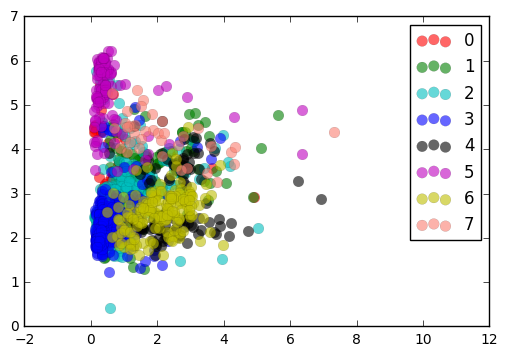

In [73]:
handles=[]
colors=['r', 'g', 'c', 'b', 'k', 'm', 'y', '#FA8072', '#CD853F', '#800080', '#40E0D0']
for i in range(numClusters):
    inds = np.where(labels==i)
    handles.append(plt.scatter(feats[inds,12],feats[inds,0],c=colors[i],linewidths=0.1,s=60,alpha=0.6))
plt.legend(handles,np.arange(numClusters))

In [181]:
labels.shape

(88,)

(-0.2, 10.2)

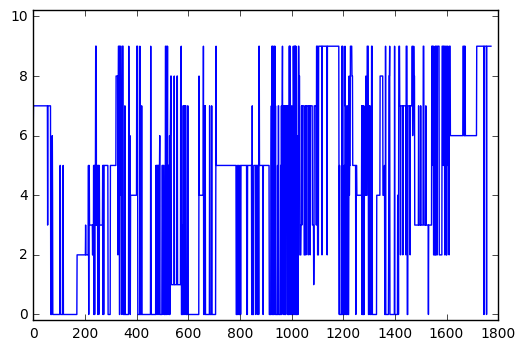

In [313]:
plt.plot(labels)

plt.ylim([-0.2,10.2])

In [61]:
mixotes=[]
writeFiles = False
for j in range(numClusters):
    clusterSelect = j
    segmInds = np.where(labels==clusterSelect)[0]
    someInds = np.random.choice(segmInds,10,replace=False)
    someInds
    mixote = np.array([])
    for i in range(len(someInds)):
        mixote = np.append(mixote,waveforms[someInds[i]])
    mixotes.append(mixote)
    
if writeFiles:
    for i in range(numClusters):
        filename='sounds/cluster'+str(i)+'.wav'
        write(filename,44100,mixotes[i])